In [1]:
# Define a function to check whether the sun is up for a given timestamp
def is_daytime(timestamp):
    s = sun(location.observer, date=timestamp.date())
    return s['sunrise'].time() < timestamp.time() < s['sunset'].time()

def is_holiday(timestamp):
    return cal.is_working_day(timestamp)

def get_season(timestamp):
    if (timestamp.month > 11 or timestamp.month < 3):
        return 'WINTER'
    elif (timestamp.month == 3 or timestamp.month <=5):
        return 'SPRING'
    elif (timestamp.month >=6 and timestamp.month <=9):
        return 'SUMMER'
    else:
        return 'FALL'

def calendar_features(df, hour=True, weekday=True, month=True, quarter=True):
    features = df.copy()
    columns = []
    if hour:
        features['HOUR'] = features.timestamp.dt.hour
        columns.append('HOUR')
    if weekday:
        features['WEEKDAY'] = features.timestamp.dt.dayofweek
        columns.append('WEEKDAY')
    if month:
        features['MONTH'] = features.timestamp.dt.month
        columns.append('MONTH')
    if quarter:
        features['QUARTER'] = features.timestamp.dt.quarter
        columns.append('QUARTER')
        
    dummies = pd.get_dummies(features[columns], columns=columns)
    
    return dummies

def window_metrics_15m(df, target, lag=True, ma=True, maxi=True, mini=True, suma=True, diff=True, entropy=False, zscore=False, 
                       cos=False, freq=[32, 96, 672]):
    
    features = df.copy()
    
    
    for i in range(1,25):
        
        if i < 4:
            
            if lag:
                features['LAG_'+str((i)*15)+'MIN'] = features[target].shift((i))
                features['LAG_'+str(i)+'H'] = features[target].shift((i)*4)
                features['LAG_'+str(i)+'D'] = features[target].shift((i)*96)
            if ma:
                features['MA_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').mean()
                features['MA_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').mean()
                features['MA_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').mean()
            if maxi:
                features['MAX_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').max()
                features['MAX_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').max()
                features['MAX_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').max()
            if mini:
                features['MIN_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').min()
                features['MIN_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').min()
                features['MIN_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').min()
            if suma:
                features['SUM_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').sum()
                features['SUM_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').sum()
                features['SUM_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').sum()
            if diff:
                features['DIFF_96_'+str((i)*15)+'MIN'] = features[target].shift((i)).diff(96)
                features['DIFF_96_'+str(i)+'H'] = features[target].shift((i)*4).diff(96)
                features['DIFF_96_'+str(i)+'D'] = features[target].shift((i)*96).diff(96)
                features['DIFF_672_'+str((i)*15)+'MIN'] = features[target].shift((i)).diff(672)
                features['DIFF_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(672)
                features['DIFF_672_'+str(i)+'D'] = features[target].shift((i)*96).diff(672)
                features['DIFF_96_672_'+str((i)*15)+'MIN'] = features[target].shift((i)).diff(96).diff(672)
                features['DIFF_96_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(96).diff(672)
                features['DIFF_96_672_'+str(i)+'D'] = features[target].shift((i)*96).diff(96).diff(672)
            if entropy:
                features['ENTROPY_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
                features['ENTROPY_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
                features['ENTROPY_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
            if zscore:
                features['ZSCORE_'+str((i+1)*15)+'MIN'] = features[target].rolling((i+1), closed='left').apply(lambda x: zscore(x)[-1], raw=True)
                features['ZSCORE_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: zscore(x)[-1], raw=True)
                features['ZSCORE_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').apply(lambda x: zscore(x)[-1], raw=True)
            if cos:
                for k in freq:
                    features['COS_'+str(k)+'_LAG_'+str((i)*15)+'MIN'] = np.cos(features[target].shift((i))/k)
                    features['COS_'+str(k)+'_LAG_'+str(i)+'H'] = np.cos(features[target].shift((i)*4)/k)
                    features['COS_'+str(k)+'_LAG_'+str(i)+'D'] = np.cos(features[target].shift((i)*96)/k)
             
        elif i > 7:
            
            if lag:
                features['LAG_'+str(i)+'H'] = features[target].shift((i)*4)
            if ma:
                features['MA_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').mean()
            if maxi:
                features['MAX_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').max()
            if mini:
                features['MIN_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').min()
            if suma:
                features['SUM_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').sum()
            if diff:
                features['DIFF_96_'+str(i)+'H'] = features[target].shift((i)*4).diff(96)
                features['DIFF_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(672)
                features['DIFF_96_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(96).diff(672)
            if entropy:
                features['ENTROPY_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
            if zscore:
                features['ZSCORE_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: zscore(x)[-1], raw=True)
            if cos:
                for k in freq:
                    features['COS_'+str(k)+'_LAG_'+str(i)+'H'] = np.cos(features[target].shift((i)*4)/k)
            
        else:
            if lag:
                features['LAG_'+str(i)+'H'] = features[target].shift((i)*4)
                features['LAG_'+str(i)+'D'] = features[target].shift((i)*96)
            if ma:
                features['MA_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').mean()
                features['MA_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').mean()
            if maxi:
                features['MAX_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').max()
                features['MAX_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').max()
            if mini:
                features['MIN_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').min()
                features['MIN_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').min()
            if suma:
                features['SUM_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').sum()
                features['SUM_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').sum()
            if diff:
                features['DIFF_96_'+str(i)+'H'] = features[target].shift((i)*4).diff(96)
                features['DIFF_96_'+str(i)+'D'] = features[target].shift((i)*96).diff(96)
                features['DIFF_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(672)
                features['DIFF_672_'+str(i)+'D'] = features[target].shift((i)*96).diff(672)
                features['DIFF_96_672_'+str(i)+'H'] = features[target].shift((i)*4).diff(96).diff(672)
                features['DIFF_96_672_'+str(i)+'D'] = features[target].shift((i)*96).diff(96).diff(672)
            if entropy:
                features['ENTROPY_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
                features['ENTROPY_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').apply(lambda x: entropy(np.histogram(x, bins='fd')[0]), raw=True)
            if zscore:
                features['ZSCORE_'+str(i)+'H'] = features[target].rolling((i)*4, closed='left').apply(lambda x: zscore(x)[-1], raw=True)
                features['ZSCORE_'+str(i)+'D'] = features[target].rolling((i)*96, closed='left').apply(lambda x: zscore(x)[-1], raw=True)
            if cos:
                for k in freq:
                    features['COS_'+str(k)+'_LAG_'+str(i)+'H'] = np.cos(features[target].shift((i)*4)/k)
                    features['COS_'+str(k)+'_LAG_'+str(i)+'D'] = np.cos(features[target].shift((i)*96)/k)
    return features.drop(columns=[target])

# Importing the data

In [2]:
%%time
#General libraries
import pandas as pd
import numpy as np
import glob as glob
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from datetime import datetime, timedelta

#Libraries for feature engineering
from astral.sun import sun
from astral import LocationInfo
from workalendar.europe import Germany
from scipy.stats import entropy, zscore

#Machine learning libraries
from pycaret.regression import *
from sklearn.metrics import r2_score, mean_absolute_percentage_error

Wall time: 3.58 s


In [3]:
%%time
df = pd.read_excel('dataset_real_003.xlsx', sheet_name=0)

Wall time: 1.46 s


In [4]:
%%time
df2 = pd.read_excel('dataset_real_003.xlsx', sheet_name=1)

Wall time: 1.2 s


In [5]:
%%time
data = pd.merge(df, df2, on='Date', how='outer')

Wall time: 11 ms


In [6]:
%%time
data['consumption'] = data['Consumption (kWh)_x'] + data['Consumption (kWh)_y']

Wall time: 1e+03 µs


In [7]:
%%time
data = data[['Date','consumption']]
data.columns = ['timestamp','consumption']
df = data.copy()

Wall time: 7.01 ms


# Inicial analysis

In [8]:
df

,timestamp,consumption
0,2021-01-01 00:00:00,79.780
1,2021-01-01 00:15:00,84.725
2,2021-01-01 00:30:00,77.280
3,2021-01-01 00:45:00,84.725
4,2021-01-01 01:00:00,82.225
...,...,...
60191,2022-09-19 22:45:00,416.823
60192,2022-09-19 23:00:00,409.908
60193,2022-09-19 23:15:00,417.320
60194,2022-09-19 23:30:00,428.716


In [9]:
df.shape

(60196, 2)

In [10]:
df.isnull().sum()

timestamp        0
consumption    700
dtype: int64

In [11]:
df.dtypes

timestamp      datetime64[ns]
consumption           float64
dtype: object

In [12]:
df.describe()

,consumption
count,59496.000000
mean,349.229108
std,94.704696
min,18.247000
25%,287.690000
50%,362.838500
75%,416.952750
max,637.910000


# Profile analysis

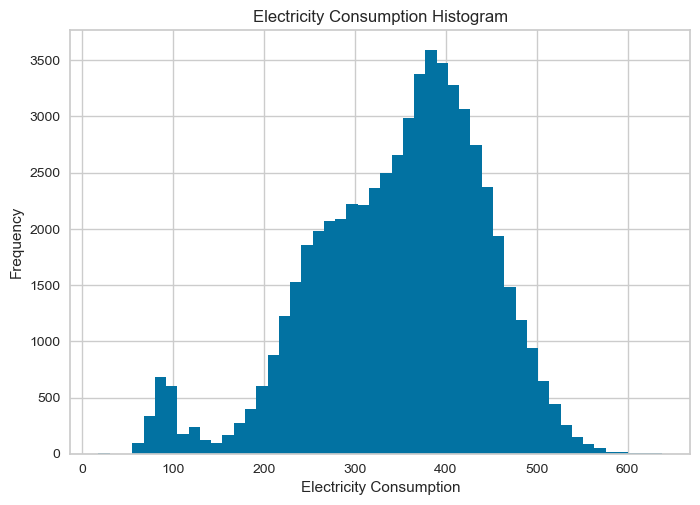

In [13]:
plt.hist(df['consumption'], bins=50)
plt.title('Electricity Consumption Histogram')
plt.xlabel('Electricity Consumption')
plt.ylabel('Frequency')
plt.show()

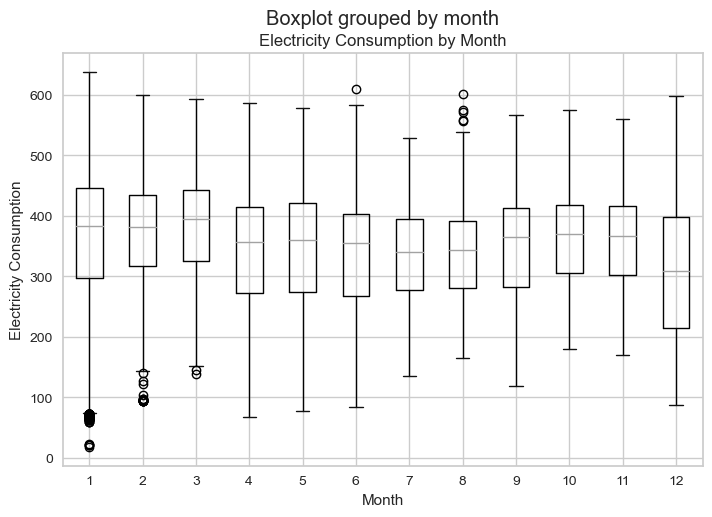

In [14]:
# Extract month from date column
df['month'] = pd.DatetimeIndex(df['timestamp']).month

# Plot a box plot of electricity consumption for each month
df.boxplot(column=['consumption'], by='month')
plt.title('Electricity Consumption by Month')
plt.xlabel('Month')
plt.ylabel('Electricity Consumption')
plt.show()

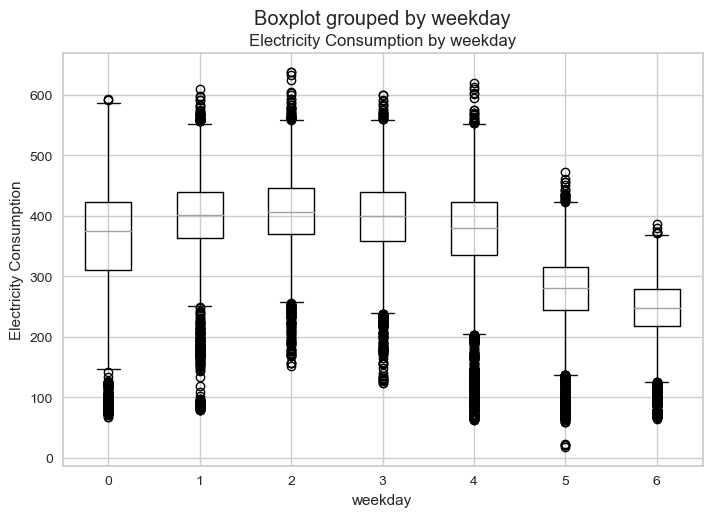

In [15]:
# Extract weekday from date column
df['weekday'] = pd.DatetimeIndex(df['timestamp']).weekday

# Plot a box plot of electricity consumption for each weekday
df.boxplot(column=['consumption'], by='weekday')
plt.title('Electricity Consumption by weekday')
plt.xlabel('weekday')
plt.ylabel('Electricity Consumption')
plt.show()

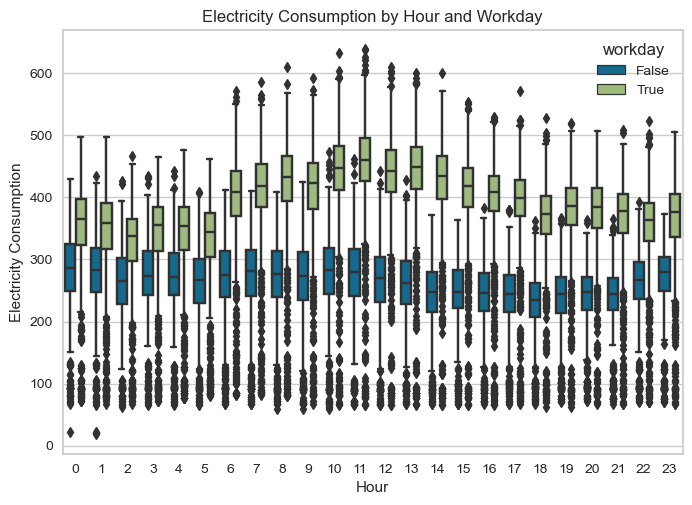

In [16]:
# Extract hour from date column
df['workday'] = (df['timestamp'].dt.dayofweek < 5)
df['hour'] = pd.DatetimeIndex(df['timestamp']).hour

# Plot a box plot of electricity consumption for each hour
sns.boxplot(x='hour', y='consumption', hue='workday', data=df)
plt.title('Electricity Consumption by Hour and Workday')
plt.xlabel('Hour')
plt.ylabel('Electricity Consumption')
plt.show()

In [17]:
# calculate mean and standard deviation
mean = df['consumption'].mean()
std = df['consumption'].std()

# calculate upper and lower bounds
upper_bound = mean + 2 * std
lower_bound = mean - 2 * std

# plot the graph
fig = px.line(df, x='timestamp', y='consumption')
fig.add_shape(type='line', x0=df['timestamp'].iloc[0], y0=upper_bound, x1=df['timestamp'].iloc[-1], y1=upper_bound, line=dict(color='red'))
fig.add_shape(type='line', x0=df['timestamp'].iloc[0], y0=lower_bound, x1=df['timestamp'].iloc[-1], y1=lower_bound, line=dict(color='red'))
fig.update_layout(title='Consumption with 2*std')
fig.show()


In [18]:
# IMPORTANT NOTE: THE DATASET HAS LESS THAN TWO WHOLE YEARS. SO IT DIDN'T GET THE BEGINING OF 2021'S AND 2022'S WINTER
# Create a new column with the season
df['season'] = df['timestamp'].apply(get_season)
df['year'] = df['timestamp'].dt.year

# Reset the index
df_grouped = df.groupby(['year', 'season'])['consumption'].sum().reset_index()

# create bar graph using plotly
fig = px.bar(df_grouped, x='year', y='consumption', color='season', barmode='group')

# set title and axis labels
fig.update_layout(title='Electricity Consumption by Season and Year',
                  xaxis_title='Year',
                  yaxis_title='Electricity Consumption')

# display the plot
fig.show()

# Feature engineering

In [19]:
df = data.copy()

In [20]:
%%time
# Define the location of interest (e.g. New York)
location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
df['is_daytime'] = df['timestamp'].apply(is_daytime).astype(int)

cal = Germany()
df['holiday'] = df['timestamp'].apply(is_holiday)
df['holiday'] = df['holiday'].astype(int)
df['holiday'] = abs(df['holiday'] -1)

df['SEASON'] = df['timestamp'].apply(get_season)
df = pd.get_dummies(df, columns=['SEASON'])

calendar_dummies = calendar_features(df)
df = pd.concat([df, calendar_dummies], axis=1)

df.index = df['timestamp']
df.drop(columns='timestamp', inplace=True)

window_features = window_metrics_15m(df[['consumption']], 'consumption')
df = pd.concat([df, window_features], axis=1)

df['WEEKEND'] = (df.index.dayofweek >= 5)

df['WORKDAY'] = 1
df.loc[(df.WEEKEND == 1) | (df.holiday == 1), 'WORKDAY'] = 0

df = df.dropna()

Wall time: 3.85 s


Wall time: 8 s


<AxesSubplot:>

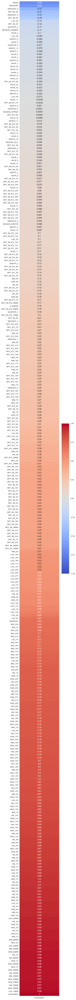

In [21]:
%%time
#day0 = monday
corr = df.corr()[['consumption']]
fig, ax = plt.subplots(figsize=(5,100))
sns.heatmap(corr.sort_values(by='consumption'), cmap='coolwarm' , vmin=-1, vmax=1, annot=True, ax=ax)

# Data setup for training

In [22]:
%%time
categorical_features=[]
for col in df.columns:
    if df[col].dtypes != 'float64':
        categorical_features.append(col)
        
test_size = int(0.2 * len(df))
train = df.iloc[:-test_size]
test = df.iloc[-test_size:]

Wall time: 4 ms


In [23]:
%%time
picareta = setup(data = train, target= 'consumption', fold_strategy='timeseries', categorical_features=categorical_features)

,Description,Value
0,Session id,2103
1,Target,consumption
2,Target type,Regression
3,Original data shape,"(39650, 328)"
4,Transformed data shape,"(39650, 328)"
5,Transformed train set shape,"(27755, 328)"
6,Transformed test set shape,"(11895, 328)"
7,Ordinal features,55
8,Numeric features,326
9,Categorical features,55


Wall time: 31.1 s


# Comparing models 

In [24]:
%%time
best = compare_models(sort = 'MAPE', exclude = ['dummy','lar', 'par', 'huber'])

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lasso,Lasso Regression,13.1115,301.4207,17.3584,0.9650,0.0520,0.0387,2.6540
lightgbm,Light Gradient Boosting Machine,13.2533,309.1996,17.5712,0.9641,0.0526,0.0387,1.6110
en,Elastic Net,13.1253,301.8796,17.3714,0.9650,0.0520,0.0388,1.6360
br,Bayesian Ridge,13.1506,302.4356,17.3869,0.9649,0.0521,0.0388,0.6530
ridge,Ridge Regression,13.0913,295.9198,17.1972,0.9657,0.0520,0.0389,0.4900
lr,Linear Regression,13.1290,297.5995,17.2452,0.9655,0.0522,0.0390,2.4230
et,Extra Trees Regressor,13.5035,321.9392,17.9331,0.9627,0.0533,0.0392,25.5560
gbr,Gradient Boosting Regressor,13.4031,316.0694,17.7724,0.9633,0.0532,0.0393,23.6840
omp,Orthogonal Matching Pursuit,13.2737,305.5359,17.4738,0.9646,0.0527,0.0394,0.5050
rf,Random Forest Regressor,13.6028,328.8150,18.1260,0.9619,0.0535,0.0394,44.1410


Processing:   0%|          | 0/61 [00:00<?, ?it/s]

Wall time: 20min 20s


In [25]:
%%time
rank = pull()

Wall time: 0 ns


### Grabing the 3 best models by algorithm category

In [26]:
%%time
algorithm_categories = {
    'Ridge Regression': 'Regularized Linear Regression',
    'Lasso Regression': 'Regularized Linear Regression',
    'Linear Regression': 'Linear Regression',
    'Elastic Net': 'Regularized Linear Regression',
    'Bayesian Ridge': 'Bayesian Regression',
    'Orthogonal Matching Pursuit': 'Sparse Regression',
    'Light Gradient Boosting Machine': 'Tree-based Ensemble Methods',
    'Gradient Boosting Regressor': 'Tree-based Ensemble Methods',
    'Extra Trees Regressor': 'Tree-based Ensemble Methods',
    'Random Forest Regressor': 'Tree-based Ensemble Methods',
    'AdaBoost Regressor': 'Boosting Methods',
    'Decision Tree Regressor': 'Tree-based Models',
    'K Neighbors Regressor': 'Nearest Neighbors',
    'Lasso Least Angle Regression': 'Regularized Linear Regression'
}
rank['Category'] = rank['Model'].apply(lambda x: algorithm_categories[x])

Wall time: 1.05 ms


In [27]:
%%time
rank = rank.groupby('Category').MAPE.min().reset_index().merge(rank.reset_index().rename(columns={'index':'abv'}), on=['Category','MAPE']).sort_values(by='MAPE').reset_index(drop=True)
# To be used later in the code to aggregate the metrics
summary = pd.DataFrame(columns=['APPROACH', 'MODEL', 'R2', 'MAPE'])
feature_importances = pd.DataFrame()

Wall time: 6.15 ms


# Model #1

In [28]:
%%time
algorithm = 0
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,13.4182,309.6230,17.5961,0.9642,0.0539,0.0402
1,13.4899,327.1483,18.0872,0.9633,0.0550,0.0399
2,13.1270,302.2665,17.3858,0.9660,0.0517,0.0389
3,12.8237,290.4984,17.0440,0.9653,0.0502,0.0377
4,13.0126,295.0638,17.1774,0.9654,0.0500,0.0379
5,13.0811,294.6409,17.1651,0.9671,0.0546,0.0396
6,12.8118,292.0743,17.0902,0.9644,0.0496,0.0373
7,12.8428,288.5428,16.9865,0.9668,0.0493,0.0376
8,13.5389,312.6986,17.6833,0.9638,0.0540,0.0399


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Lasso Regression,12.8697,287.6553,16.9604,0.9673,0.0521,0.0383


Wall time: 56.5 s


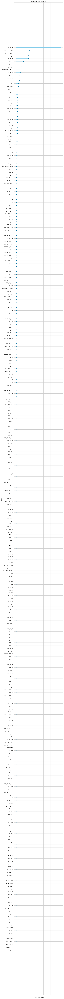

Wall time: 9.28 s


In [29]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [30]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [31]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 1.22 s


In [32]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[0], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 3 ms


## Graph performance (predicting one step ahead)

In [33]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [34]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 22.9 ms


In [35]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 26s


In [36]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[0], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 11 ms


## Graph performance recursive approach

In [37]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [38]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08


# Model #2

In [39]:
%%time
algorithm = 1
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,14.1486,352.5565,18.7765,0.9592,0.0551,0.0418
1,14.0584,355.3080,18.8496,0.9601,0.0567,0.0409
2,13.3452,310.4788,17.6204,0.9651,0.0524,0.0391
3,12.9959,294.7245,17.1675,0.9648,0.0497,0.0377
4,12.9918,296.8468,17.2292,0.9652,0.0495,0.0375
5,13.0489,297.9004,17.2598,0.9667,0.0586,0.0394
6,13.1048,302.5318,17.3934,0.9631,0.0506,0.0379
7,12.6470,279.8047,16.7274,0.9678,0.0474,0.0364
8,13.4735,312.2707,17.6712,0.9639,0.0567,0.0396


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,12.7624,284.3539,16.8628,0.9677,0.0521,0.0376


Wall time: 30.6 s


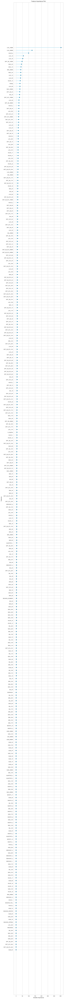

Wall time: 6.97 s


In [40]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [41]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [42]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 1.11 s


In [43]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 6.98 ms


## Graph performance (predicting one step ahead)

In [44]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [45]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 5.03 ms


In [46]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 51s


In [47]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 9.99 ms


## Graph performance recursive approach

In [48]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [49]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08
2,ONE_STEP,lightgbm,9.614131e-01,4.069226e-02
3,RECURSIVE,lightgbm,-5.304946e-01,1.186234e-01


# Model #3

In [50]:
%%time
algorithm = 2
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,13.5783,314.7190,17.7403,0.9636,0.0543,0.0408
1,13.5590,329.8128,18.1607,0.9630,0.0553,0.0402
2,13.1847,304.4970,17.4498,0.9658,0.0519,0.0391
3,12.8333,289.7230,17.0213,0.9654,0.0501,0.0377
4,13.0211,296.5625,17.2210,0.9652,0.0501,0.0379
5,13.1467,296.1936,17.2103,0.9669,0.0546,0.0397
6,12.7959,290.6633,17.0488,0.9645,0.0495,0.0373
7,12.8377,287.9167,16.9681,0.9669,0.0493,0.0376
8,13.5511,312.6442,17.6817,0.9638,0.0542,0.0399


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Bayesian Ridge,12.8714,286.7656,16.9342,0.9674,0.0521,0.0384


Wall time: 17.2 s


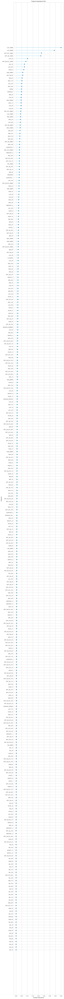

Wall time: 8.72 s


In [51]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [52]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [53]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 996 ms


In [54]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 5.11 ms


## Graph performance (predicting one step ahead)

In [55]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [56]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 5.81 ms


In [57]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 32s


In [58]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 7.04 ms


## Graph performance recursive approach

In [59]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [60]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08
2,ONE_STEP,lightgbm,9.614131e-01,4.069226e-02
3,RECURSIVE,lightgbm,-5.304946e-01,1.186234e-01
4,ONE_STEP,br,9.632766e-01,4.038671e-02
5,RECURSIVE,br,-2.714196e+18,5.614564e+07


# Model #4

In [61]:
%%time
algorithm = 3
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,13.7308,321.8295,17.9396,0.9628,0.0559,0.0414
1,13.6979,328.6956,18.1300,0.9631,0.0552,0.0407
2,13.1110,297.3674,17.2443,0.9666,0.0520,0.0392
3,12.7725,282.1334,16.7968,0.9663,0.0501,0.0378
4,12.9867,291.4165,17.0709,0.9658,0.0498,0.0379
5,13.1476,294.3391,17.1563,0.9671,0.0558,0.0402
6,12.7384,284.7485,16.8745,0.9653,0.0500,0.0374
7,12.6718,277.7116,16.6647,0.9681,0.0487,0.0373
8,13.4423,304.2708,17.4434,0.9648,0.0537,0.0397


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Linear Regression,12.7604,279.8524,16.7288,0.9682,0.0519,0.0382


Wall time: 18.2 s


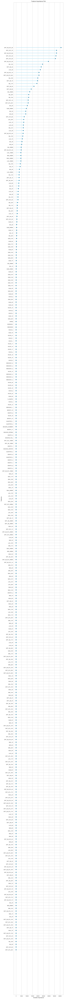

Wall time: 8.94 s


In [62]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [63]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [64]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 984 ms


In [65]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 3 ms


## Graph performance (predicting one step ahead)

In [66]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [67]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 4 ms


In [68]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 38s


In [69]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 7.25 ms


## Graph performance recursive approach

In [70]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [71]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08
2,ONE_STEP,lightgbm,9.614131e-01,4.069226e-02
3,RECURSIVE,lightgbm,-5.304946e-01,1.186234e-01
4,ONE_STEP,br,9.632766e-01,4.038671e-02
5,RECURSIVE,br,-2.714196e+18,5.614564e+07
6,ONE_STEP,lr,9.637372e-01,4.000156e-02
7,RECURSIVE,lr,-3.850061e+17,2.511264e+07


# Model #5

In [72]:
%%time
algorithm = 4
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,13.9030,332.5661,18.2364,0.9615,0.0569,0.0419
1,13.6232,332.2399,18.2274,0.9627,0.0561,0.0407
2,13.3101,303.5570,17.4229,0.9659,0.0519,0.0396
3,12.8046,285.0012,16.8820,0.9660,0.0503,0.0380
4,13.1713,300.5300,17.3358,0.9648,0.0506,0.0385
5,13.1141,296.2874,17.2130,0.9669,0.0554,0.0399
6,12.9469,293.8124,17.1410,0.9642,0.0505,0.0380
7,12.9370,289.6253,17.0184,0.9667,0.0498,0.0381
8,13.7256,317.6928,17.8239,0.9632,0.0539,0.0404


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Orthogonal Matching Pursuit,12.9271,287.5850,16.9583,0.9673,0.0524,0.0387


Wall time: 16.4 s


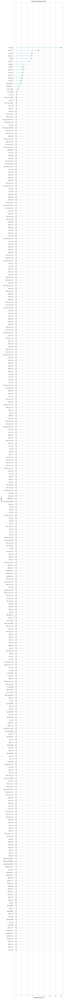

Wall time: 8.74 s


In [73]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [74]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [75]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 1.03 s


In [76]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 2 ms


## Graph performance (predicting one step ahead)

In [77]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [78]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 4.2 ms


In [79]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 18s


In [80]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 7.89 ms


## Graph performance recursive approach

In [81]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [82]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08
2,ONE_STEP,lightgbm,9.614131e-01,4.069226e-02
3,RECURSIVE,lightgbm,-5.304946e-01,1.186234e-01
4,ONE_STEP,br,9.632766e-01,4.038671e-02
5,RECURSIVE,br,-2.714196e+18,5.614564e+07
6,ONE_STEP,lr,9.637372e-01,4.000156e-02
7,RECURSIVE,lr,-3.850061e+17,2.511264e+07
8,ONE_STEP,omp,9.629516e-01,4.064609e-02
9,RECURSIVE,omp,-1.132035e+03,2.211517e+00


In [83]:
feature_importances.groupby('Algorithm').count()

,Feature,Value
Algorithm,,
br,327,327
lasso,327,327
lightgbm,327,327
lr,327,327
omp,327,327


# Model #6

In [84]:
%%time
algorithm = 5
model = create_model(rank.abv[algorithm])
prediction_holdout = predict_model(model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,16.1987,439.2971,20.9594,0.9492,0.0707,0.0517
1,16.0100,444.2511,21.0773,0.9501,0.0648,0.0477
2,16.0401,436.8340,20.9006,0.9509,0.0641,0.0484
3,15.8025,420.9251,20.5165,0.9497,0.0611,0.0470
4,15.8833,428.9602,20.7114,0.9497,0.0620,0.0476
5,16.2997,440.4780,20.9876,0.9508,0.0724,0.0517
6,15.7016,418.8865,20.4667,0.9489,0.0602,0.0465
7,15.8140,416.8221,20.4162,0.9521,0.0617,0.0479
8,16.1710,433.5634,20.8222,0.9498,0.0677,0.0494


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,AdaBoost Regressor,16.5104,449.4085,21.1993,0.9490,0.0688,0.0514


Wall time: 2min 30s


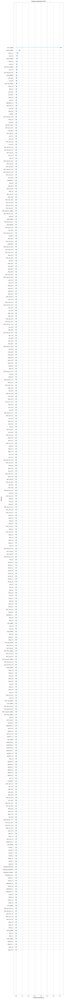

Wall time: 6.32 s


In [85]:
%%time
plot_model(model, plot = 'feature_all', use_train_data = True)

In [86]:
try:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.coef_)}).sort_values(by='Value', ascending=False)
except:
    model_feature_importances = pd.DataFrame({'Feature': get_config('X_train').columns, 'Value' : abs(model.feature_importances_)}).sort_values(by='Value', ascending=False)
    
model_feature_importances['Algorithm'] = rank.abv[algorithm]

feature_importances = pd.concat([feature_importances, model_feature_importances])

In [87]:
%%time
prediction = predict_model(model, data = test.drop(columns='consumption'))

Wall time: 1.3 s


In [88]:
%%time
r2 = r2_score(test.consumption, prediction.prediction_label)
mape = mean_absolute_percentage_error(test.consumption, prediction.prediction_label)
summary = summary.append({'APPROACH': 'ONE_STEP', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 3 ms


## Graph performance (predicting one step ahead)

In [89]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=test.index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=test.index, y=prediction.prediction_label,
                    mode='lines',
                    name='Predicted'))
fig.show()

## Using recursive approach

In [90]:
%%time
updated_series = train.tail(5000).copy();

Wall time: 4 ms


In [91]:
%%time
horizon = 300
for i in range(1, horizon):
    step = 15
    next_step = updated_series.index[-1] + timedelta(minutes=step)
    updated_series.loc[next_step] = 0
    prediction = predict_model(model, data = updated_series.iloc[[-2]].drop(columns='consumption')).prediction_label
    updated_series['consumption'].iloc[-1] = prediction.iloc[0]
      
    updated_series['timestamp'] = updated_series.index

    # Define the location of interest (e.g. New York)
    location = LocationInfo("Werther", "Germany", "Europe/Berlin", 52.0794, 8.4399)
    updated_series['is_daytime'] = updated_series['timestamp'].apply(is_daytime).astype(int)

    cal = Germany()
    updated_series['holiday'] = updated_series['timestamp'].apply(is_holiday)
    updated_series['holiday'] = updated_series['holiday'].astype(int)
    updated_series['holiday'] = abs(updated_series['holiday'] -1)

    updated_series['SEASON'] = updated_series['timestamp'].apply(get_season)
    season_dummies = pd.get_dummies(updated_series['SEASON'], prefix='SEASON')
    updated_series.update(season_dummies)
    
    calendar_dummies = calendar_features(updated_series)
    updated_series.update(calendar_dummies)
    
    updated_series.index = updated_series['timestamp']
    updated_series.drop(columns='timestamp', inplace=True)

    window_features = window_metrics_15m(updated_series[['consumption']], 'consumption')
    updated_series.update(window_features)

    updated_series['WEEKEND'] = (updated_series.index.dayofweek >= 5)

    updated_series['WORKDAY'] = 1
    updated_series.loc[(updated_series.WEEKEND == 1) | (updated_series.holiday == 1), 'WORKDAY'] = 0

Wall time: 5min 18s


In [92]:
%%time
r2 = r2_score(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
mape = mean_absolute_percentage_error(test[test.index.isin(updated_series.index)].consumption, updated_series[updated_series.index.isin(test.index)].consumption)
summary = summary.append({'APPROACH': 'RECURSIVE', 'MODEL': rank.abv[algorithm], 'R2': r2, 'MAPE': mape}, ignore_index=True)

Wall time: 7.09 ms


## Graph performance recursive approach

In [93]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=test.consumption,
                    mode='lines',
                    name='Real'))
fig.add_trace(go.Scatter(x=updated_series[updated_series.index.isin(test.index)].index, y=updated_series[updated_series.index.isin(test.index)].consumption,
                    mode='lines',
                    name='Predicted'))
fig.show()

In [94]:
summary

,APPROACH,MODEL,R2,MAPE
0,ONE_STEP,lasso,9.631863e-01,4.035409e-02
1,RECURSIVE,lasso,-9.590321e+19,3.309526e+08
2,ONE_STEP,lightgbm,9.614131e-01,4.069226e-02
3,RECURSIVE,lightgbm,-5.304946e-01,1.186234e-01
4,ONE_STEP,br,9.632766e-01,4.038671e-02
5,RECURSIVE,br,-2.714196e+18,5.614564e+07
6,ONE_STEP,lr,9.637372e-01,4.000156e-02
7,RECURSIVE,lr,-3.850061e+17,2.511264e+07
8,ONE_STEP,omp,9.629516e-01,4.064609e-02
9,RECURSIVE,omp,-1.132035e+03,2.211517e+00


In [95]:
feature_importances.groupby('Algorithm').count()

,Feature,Value
Algorithm,,
ada,327,327
br,327,327
lasso,327,327
lightgbm,327,327
lr,327,327
omp,327,327


In [96]:
filename = 'Roadmap'
summary['FILE'] = filename

In [97]:
summary.to_excel(filename+'.xlsx')